<a href="https://colab.research.google.com/github/Offliners/ML-writeup/blob/main/HW6/homework6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Homework 6 - Generative Adversarial Network**

This is the example code of homework 6 of the machine learning course by Prof. Hung-yi Lee.


In this homework, you are required to build a generative adversarial  network for anime face generation.


## Set up the environment


### Packages Installation

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!nvidia-smi

Sat Apr 17 09:48:34 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.67       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
# You may replace the workspace directory if you want.
workspace_dir = './drive/MyDrive/HW6'

# Training progress bar
!pip install -q qqdm

### Download the dataset
**Please use the link according to the last digit of your student ID first!**

If all download links fail, please follow [here](https://drive.google.com/drive/folders/13T0Pa_WGgQxNkqZk781qhc5T9-zfh19e).

* To open the file using your browser, use the link below (replace the id first!):
https://drive.google.com/file/d/REPLACE_WITH_ID
* e.g. https://drive.google.com/file/d/1IGrTr308mGAaCKotpkkm8wTKlWs9Jq-p

In [4]:
!gdown --id 1XpV2G-vOpCH72NU0aWRDToJQf6HbQeBX --output "./crypko_data.zip"
# Other download links
#   Please uncomment the line according to the last digit of your student ID first

# 0
# !gdown --id 131zPaVoi-U--XThvzgRfaxrumc3YSBd3 --output "{workspace_dir}/crypko_data.zip"

# 1
# !gdown --id 1kCuIj1Pf3T2O94H9bUBxjPBKb---WOmH --output "{workspace_dir}/crypko_data.zip"

# 2
# !gdown --id 1boEoiiqBJwoHVvjmI0xgoutE9G0Rv8CD --output "{workspace_dir}/crypko_data.zip"

# 3
# !gdown --id 1Ic0mktAQQvnNAnswrPHsg-u2OWGBXTWF --output "{workspace_dir}/crypko_data.zip"

# 4
# !gdown --id 1PFcc25r9tLE7OyQ-CDadtysNdWizk6Yg --output "{workspace_dir}/crypko_data.zip"

# 5
# !gdown --id 1wgkrYkTrhwDSMdWa5NwpXeE4-7JaUuX2 --output "{workspace_dir}/crypko_data.zip"

# 6
# !gdown --id 19gwNYWi9gN9xVL86jC3v8qqNtrXyq5Bf --output "{workspace_dir}/crypko_data.zip"

# 7 
# !gdown --id 1-KPZB6frRSRLRAtQfafKCVA7em0_NrJG --output "{workspace_dir}/crypko_data.zip"

# 8
# !gdown --id 1rNBfmn0YBzXuG5ub7CXbsGwduZqEs8hx --output "{workspace_dir}/crypko_data.zip"

# 9
# !gdown --id 113NEISX-2j6rBd1yyBx0c3_9nPIzSNz- --output "{workspace_dir}/crypko_data.zip"


Downloading...
From: https://drive.google.com/uc?id=1XpV2G-vOpCH72NU0aWRDToJQf6HbQeBX
To: /content/crypko_data.zip
452MB [00:03, 146MB/s]


###Unzip the downloaded file.
The unzipped tree structure is like 
```
faces/
├── 1.jpg
├── 2.jpg
├── 3.jpg
...
```

In [5]:
!unzip -q "./crypko_data.zip" -d "./"

## Random seed
Set the random seed to a certain value for reproducibility.

In [6]:
import random

import torch
import numpy as np


def same_seeds(seed):
    # Python built-in random module
    random.seed(seed)
    # Numpy
    np.random.seed(seed)
    # Torch
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

same_seeds(2021)

## Import Packages
First, we need to import packages that will be used later.

Like hw3, we highly rely on **torchvision**, a library of PyTorch.

In [7]:
import os
import glob

import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torch import optim
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
from qqdm.notebook import qqdm

## Dataset
1. Resize the images to (64, 64)
1. Linearly map the values from [0, 1] to  [-1, 1].

Please refer to [PyTorch official website](https://pytorch.org/vision/stable/transforms.html) for details about different transforms.


In [8]:
class CrypkoDataset(Dataset):
    def __init__(self, fnames, transform):
        self.transform = transform
        self.fnames = fnames
        self.num_samples = len(self.fnames)

    def __getitem__(self,idx):
        fname = self.fnames[idx]
        # 1. Load the image
        img = torchvision.io.read_image(fname)
        # 2. Resize and normalize the images using torchvision.
        img = self.transform(img)
        return img

    def __len__(self):
        return self.num_samples


def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    # 1. Resize the image to (64, 64)
    # 2. Linearly map [0, 1] to [-1, 1]
    compose = [
        transforms.ToPILImage(),
        transforms.Resize((64, 64)),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
    ]
    transform = transforms.Compose(compose)
    dataset = CrypkoDataset(fnames, transform)
    return dataset

### Show some images
Note that the values are in the range of [-1, 1], we should shift them to the valid range, [0, 1], to display correctly.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


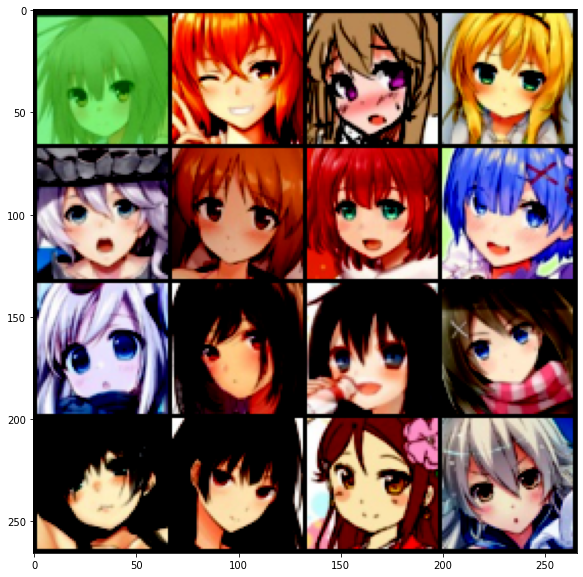

In [9]:
dataset = get_dataset(os.path.join('.', 'faces'))

images = [dataset[i] for i in range(16)]
grid_img = torchvision.utils.make_grid(images, nrow=4)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

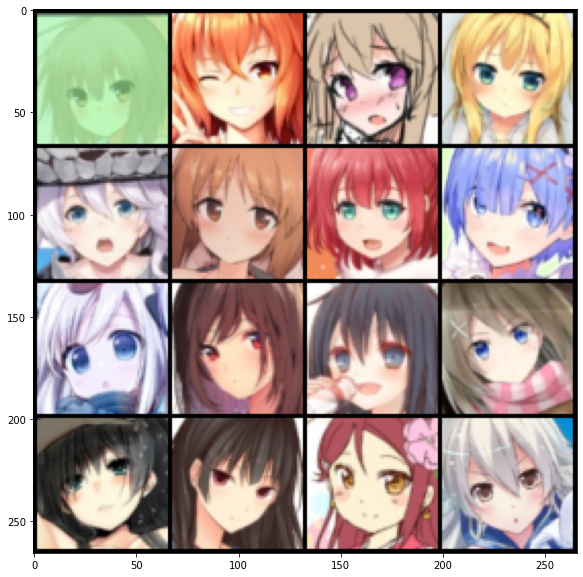

In [10]:
images = [(dataset[i]+1)/2 for i in range(16)]
grid_img = torchvision.utils.make_grid(images, nrow=4)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

## Model
Here, we use a simple CNN-based model structure. Feel free to modify your own model structure.

Note that the `N` of the input/output shape stands for the batch size.

In [11]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    """
    Input shape: (N, in_dim)
    Output shape: (N, 3, 64, 64)
    """
    def __init__(self, in_dim, dim=64):
        super(Generator, self).__init__()
        def dconv_bn_relu(in_dim, out_dim):
            return nn.Sequential(
                nn.ConvTranspose2d(in_dim, out_dim, 5, 2,
                                   padding=2, output_padding=1, bias=False),
                nn.BatchNorm2d(out_dim),
                nn.ReLU()
            )
        self.l1 = nn.Sequential(
            nn.Linear(in_dim, dim * 8 * 4 * 4, bias=False),
            nn.BatchNorm1d(dim * 8 * 4 * 4),
            nn.ReLU()
        )
        self.l2_5 = nn.Sequential(
            dconv_bn_relu(dim * 8, dim * 4),
            dconv_bn_relu(dim * 4, dim * 2),
            dconv_bn_relu(dim * 2, dim),
            nn.ConvTranspose2d(dim, 3, 5, 2, padding=2, output_padding=1),
            nn.Tanh()
        )
        self.apply(weights_init)

    def forward(self, x):
        y = self.l1(x)
        y = y.view(y.size(0), -1, 4, 4)
        y = self.l2_5(y)
        return y


class Discriminator(nn.Module):
    """
    Input shape: (N, 3, 64, 64)
    Output shape: (N, )
    """
    def __init__(self, in_dim, dim=64):
        super(Discriminator, self).__init__()

        def conv_bn_lrelu(in_dim, out_dim):
            return nn.Sequential(
                nn.Conv2d(in_dim, out_dim, 5, 2, 2),
                nn.BatchNorm2d(out_dim),
                nn.LeakyReLU(0.2),
            )
            
        """ Medium: Remove the last sigmoid layer for WGAN. """
        self.ls = nn.Sequential(
            nn.Conv2d(in_dim, dim, 5, 2, 2), 
            nn.LeakyReLU(0.2),
            conv_bn_lrelu(dim, dim * 2),
            conv_bn_lrelu(dim * 2, dim * 4),
            conv_bn_lrelu(dim * 4, dim * 8),
            nn.Conv2d(dim * 8, 1, 4),
            # nn.Sigmoid(), 
        )
        self.apply(weights_init)
        
    def forward(self, x):
        y = self.ls(x)
        y = y.view(-1)
        return y

## Training

### Initialization
- hyperparameters
- model
- optimizer
- dataloader

In [14]:
# Training hyperparameters
batch_size = 64
z_dim = 100
z_sample = Variable(torch.randn(100, z_dim)).cuda()
lr = 1e-4

""" Medium: WGAN, 50 epoch, n_critic=5, clip_value=0.01 """
n_epoch = 50 # 50
n_critic = 5 # 5
clip_value = 0.01

log_dir = os.path.join(workspace_dir, 'logs')
ckpt_dir = os.path.join(workspace_dir, 'checkpoints')
os.makedirs(log_dir, exist_ok=True)
os.makedirs(ckpt_dir, exist_ok=True)

# Model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()

# Load Model
# checkpoint_G = torch.load(os.path.join(ckpt_dir, 'G.pth'))
# G.load_state_dict(checkpoint_G['model_state_dict'])
# loss_G = checkpoint_G['loss']

# trained_epoch = checkpoint_G['epoch']
# n_epoch = n_epoch - trained_epoch
# print(f'Trained epoch : {trained_epoch}')
# print(f'Remain epoch : {n_epoch}')

# checkpoint_D = torch.load(os.path.join(ckpt_dir, 'D.pth'))
# D.load_state_dict(checkpoint_D['model_state_dict'])
# loss_D = checkpoint_D['loss']


G.train()
D.train()

# Loss
criterion = nn.BCELoss()

""" Medium: Use RMSprop for WGAN. """
# Optimizer
# opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
# opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
opt_D = torch.optim.RMSprop(D.parameters(), lr=lr)
opt_G = torch.optim.RMSprop(G.parameters(), lr=lr)

# Load Model
# opt_G.load_state_dict(checkpoint_G['optimizer_state_dict'])
# opt_D.load_state_dict(checkpoint_D['optimizer_state_dict'])

# DataLoader
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)


### Training loop
We store some pictures regularly to monitor the current performance of the Generator, and regularly record checkpoints.

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:41<00:00:00  6.92it/s  -1.4756  0.744     1    1115           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_001.jpg.


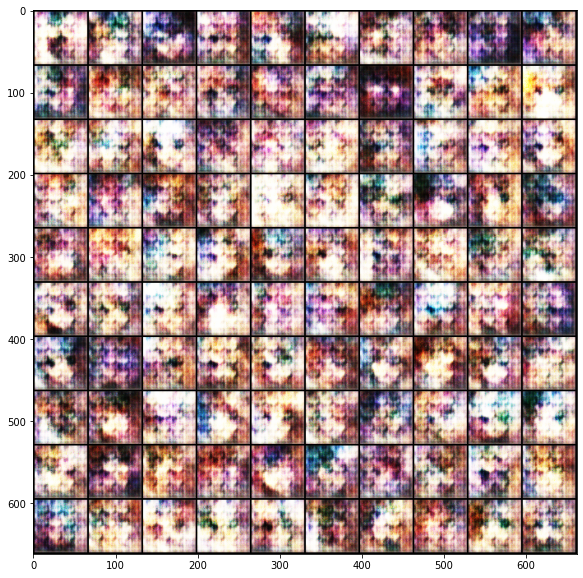

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:45<00:00:00  6.76it/s  -1.4956  0.7459    2    2230           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_002.jpg.


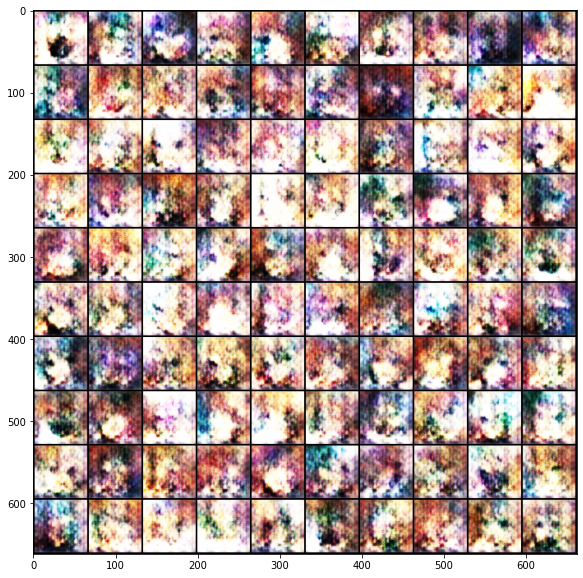

   Iters      Elapsed Time      Speed    Loss_D   Loss_G   Epoch  Step          
 1115/1115  00:02:45<00:00:00  6.75it/s  -0.3624  -0.5017    3    3345          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_003.jpg.


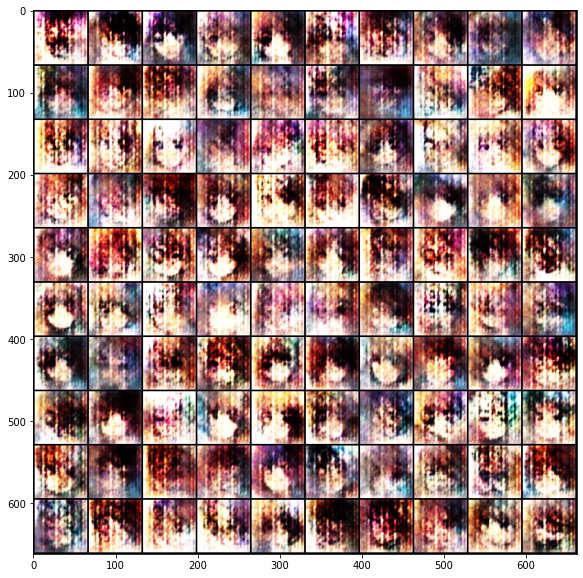

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:45<00:00:00  6.72it/s  -1.4182  0.7148    4    4460           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_004.jpg.


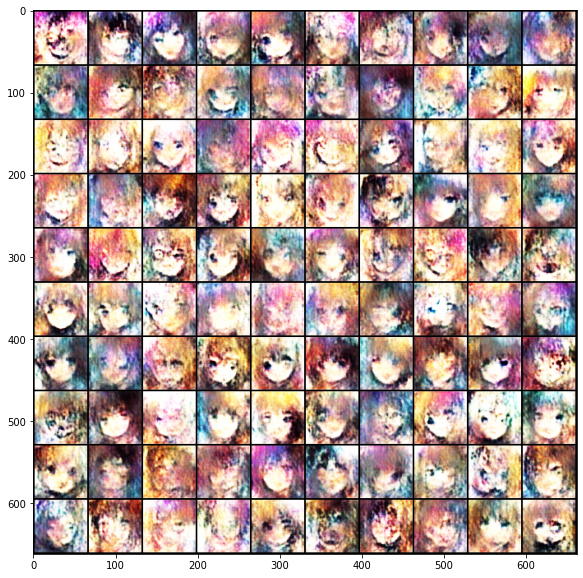

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:46<00:00:00  6.69it/s  -1.4251  0.7297    5    5575           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_005.jpg.


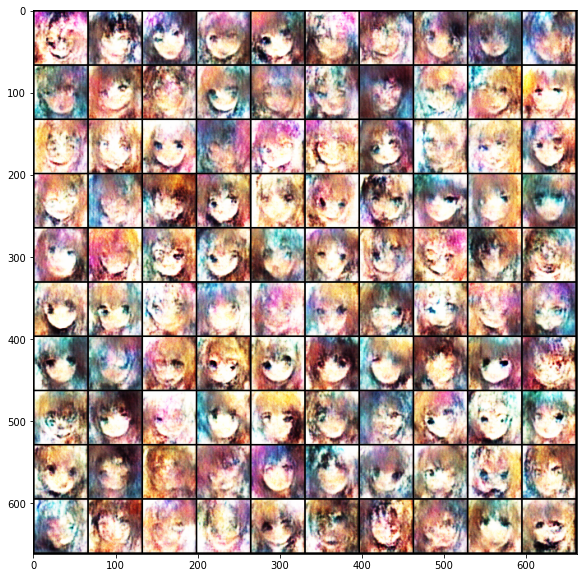

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:47<00:00:00  6.68it/s  -1.1045  0.7043    6    6690           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_006.jpg.


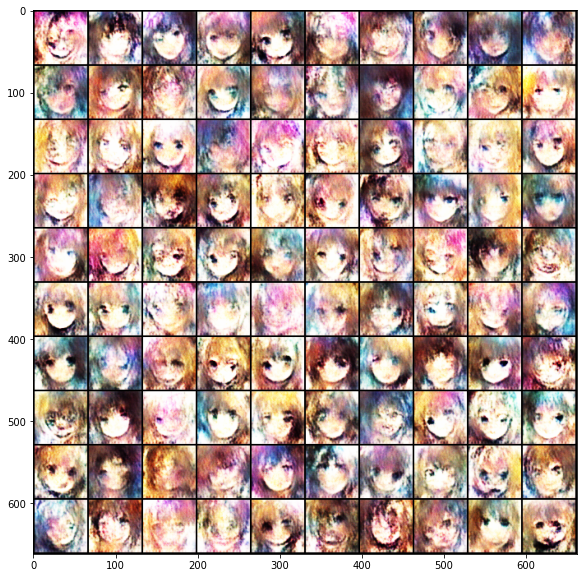

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:48<00:00:00  6.61it/s  -1.4681  0.7418    7    7805           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_007.jpg.


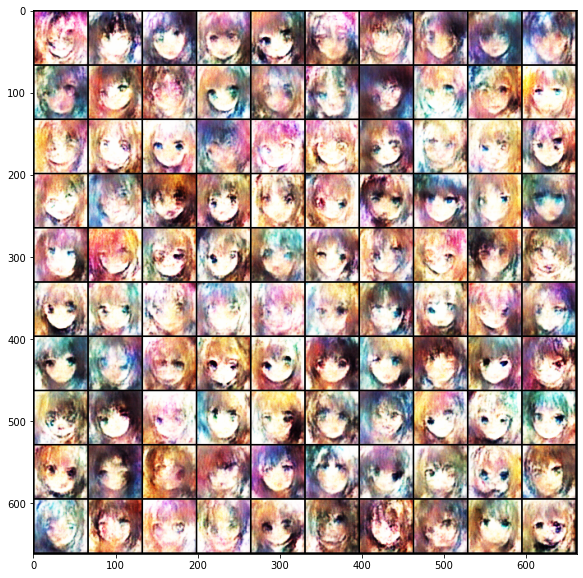

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.55it/s  -0.4595  0.7306    8    8920           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_008.jpg.


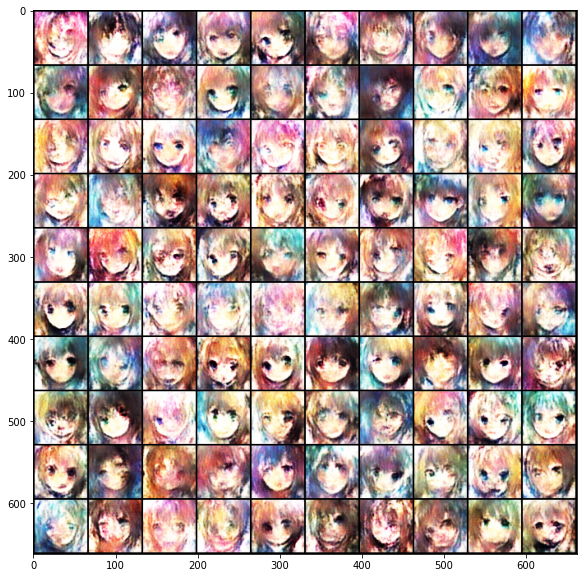

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -0.9298  0.6884    9    10035          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_009.jpg.


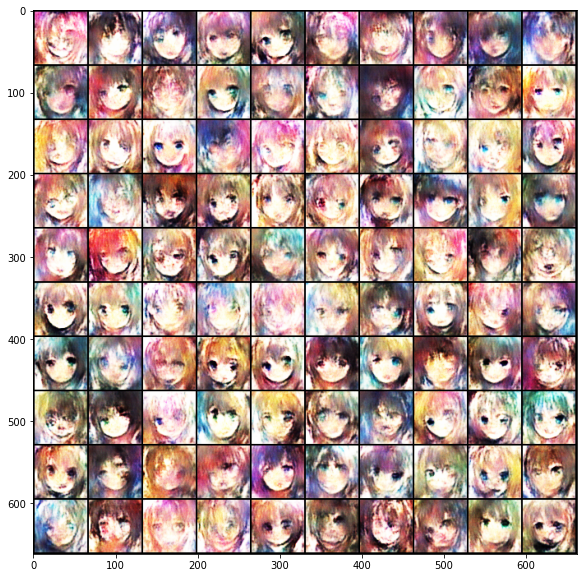

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -1.4437  0.7185   10    11150          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_010.jpg.


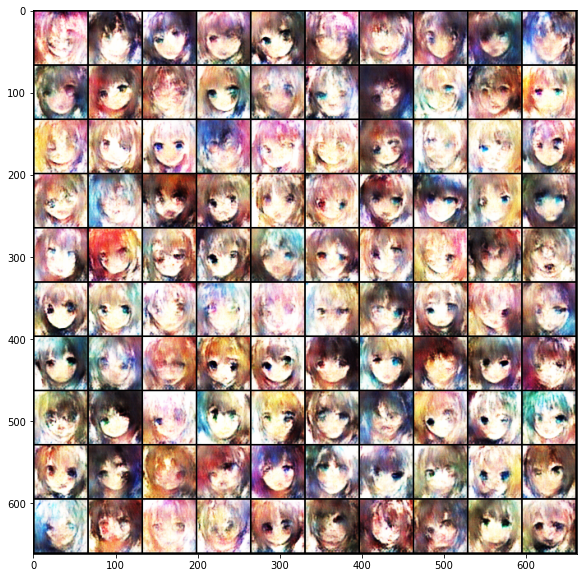

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -0.8047  0.6289   11    12265          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_011.jpg.


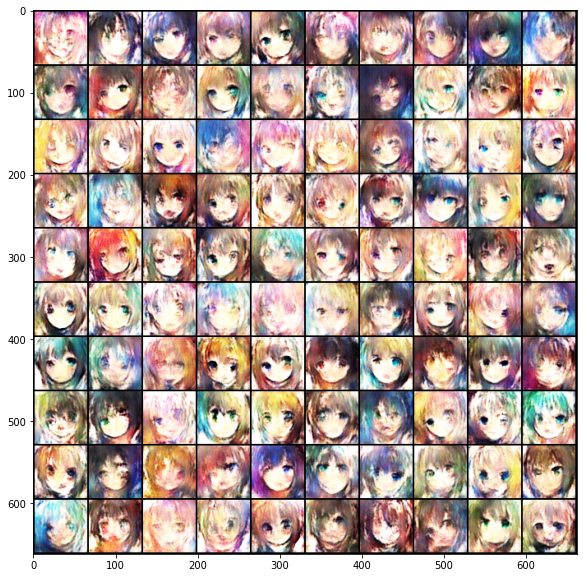

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -1.2677  0.7149   12    13380          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_012.jpg.


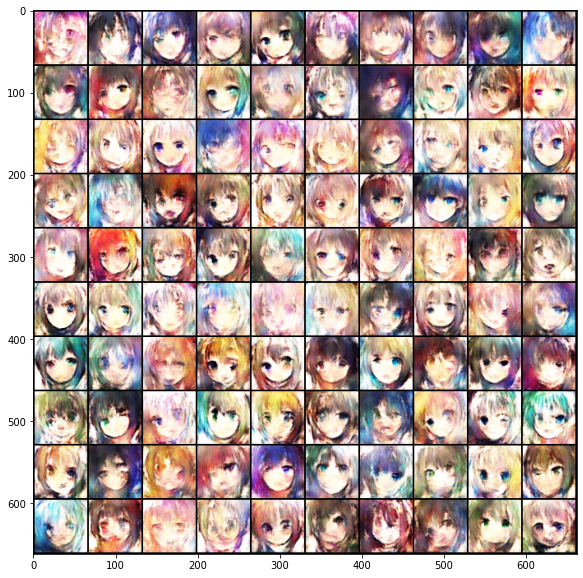

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.55it/s  -1.4021  0.7161   13    14495          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_013.jpg.


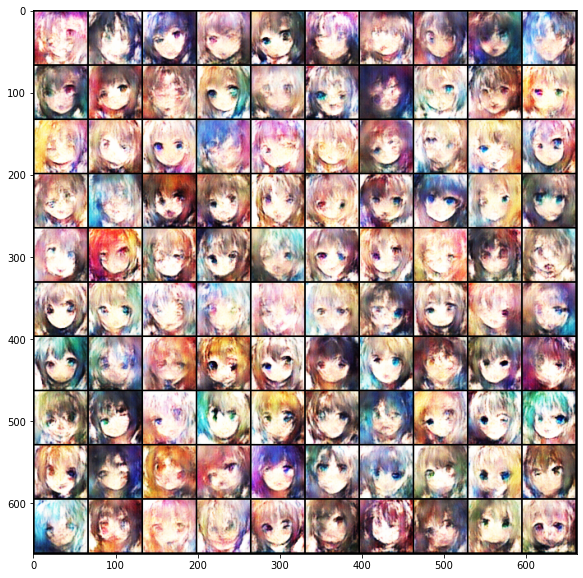

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.53it/s  -1.0273  0.5727   14    15610          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_014.jpg.


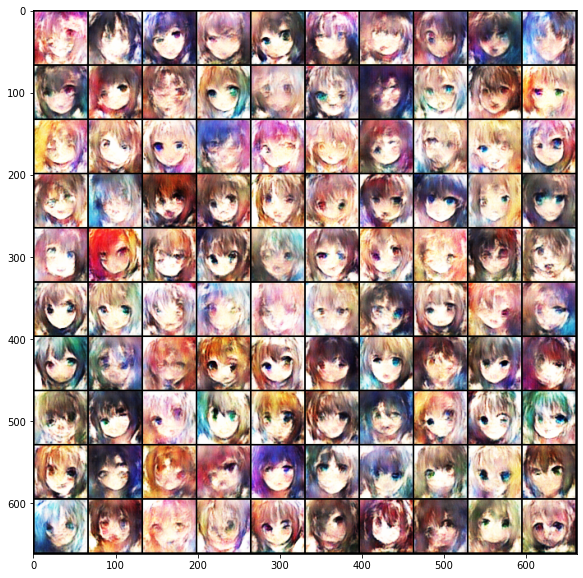

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.55it/s  -1.0295  0.3543   15    16725          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_015.jpg.


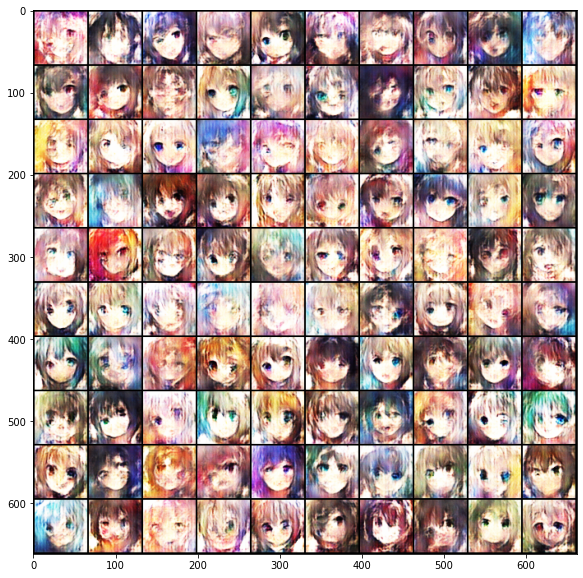

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.53it/s  -1.3581  0.6774   16    17840          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_016.jpg.


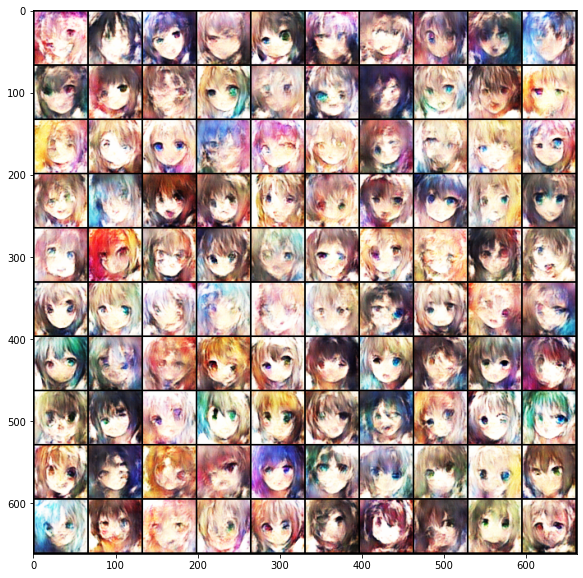

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.55it/s  -1.3045  0.6669   17    18955          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_017.jpg.


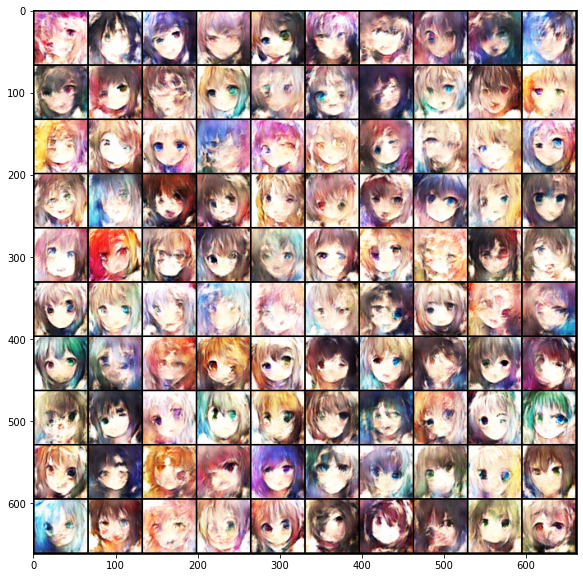

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step            
 1115/1115  00:02:50<00:00:00  6.55it/s  -1.244  0.6651   18    20070           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_018.jpg.


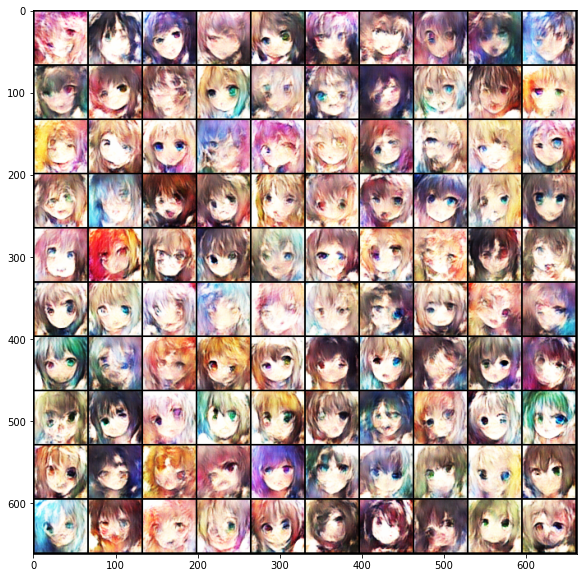

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -0.9509  0.5824   19    21185          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_019.jpg.


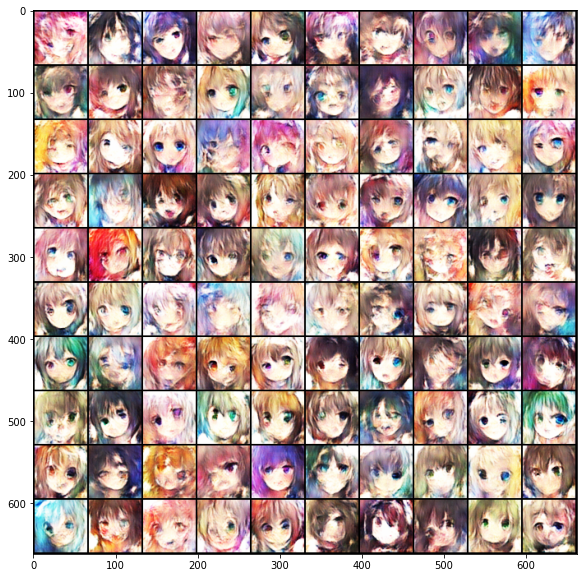

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -1.0167  0.3601   20    22300          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_020.jpg.


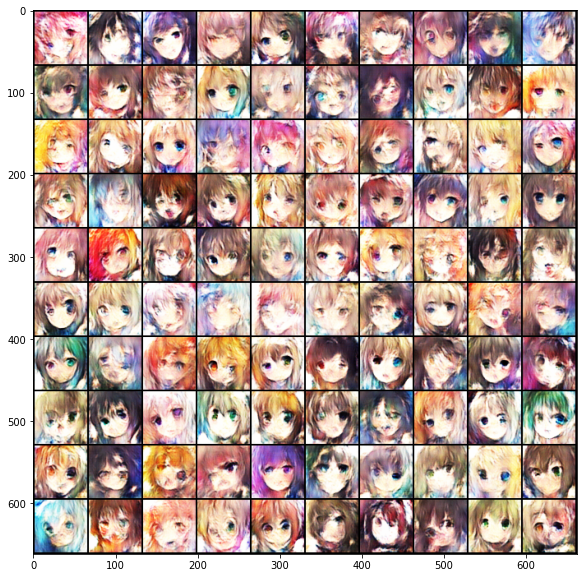

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.53it/s  -0.7322  0.5536   21    23415          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_021.jpg.


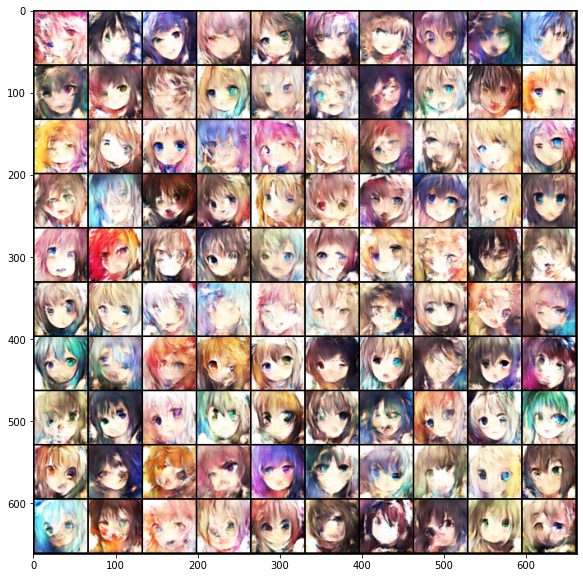

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.56it/s  -1.0014  0.5999   22    24530          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_022.jpg.


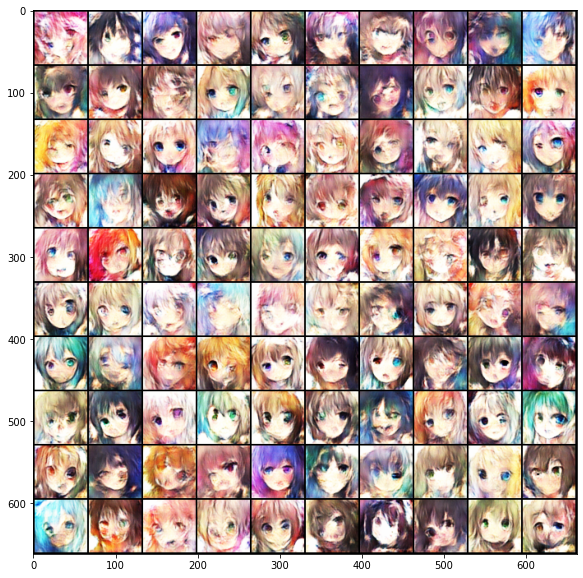

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -0.9762  0.5798   23    25645          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_023.jpg.


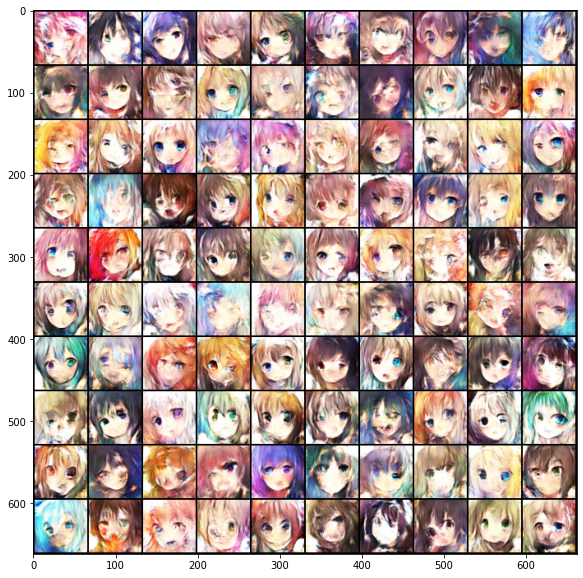

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -1.3415  0.6543   24    26760          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_024.jpg.


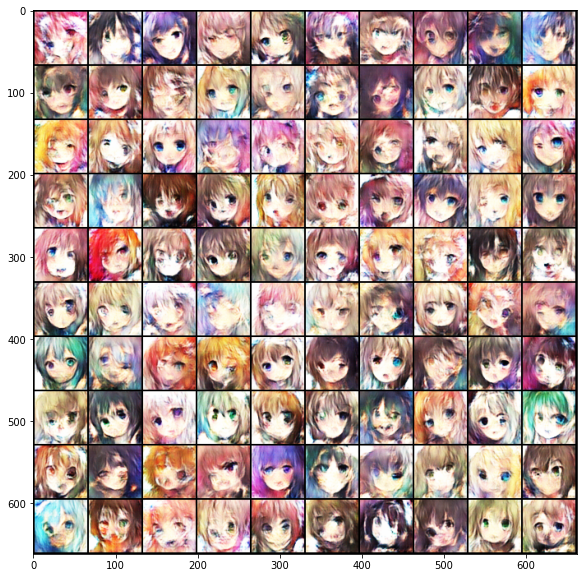

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.54it/s  -0.7177  0.4593   25    27875          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_025.jpg.


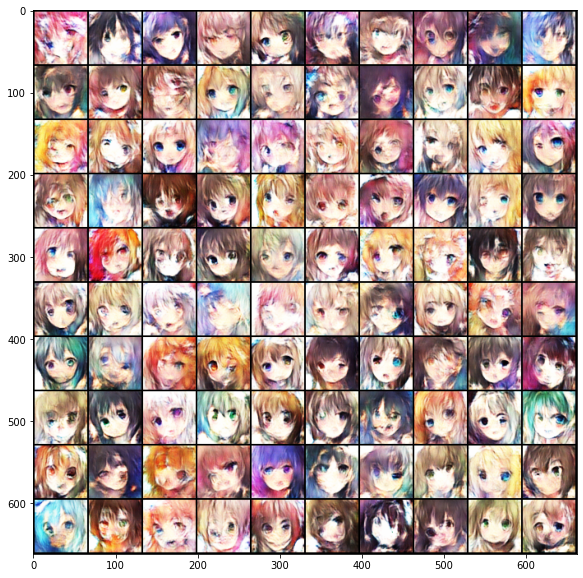

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.55it/s  -1.1748  0.6416   26    28990          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_026.jpg.


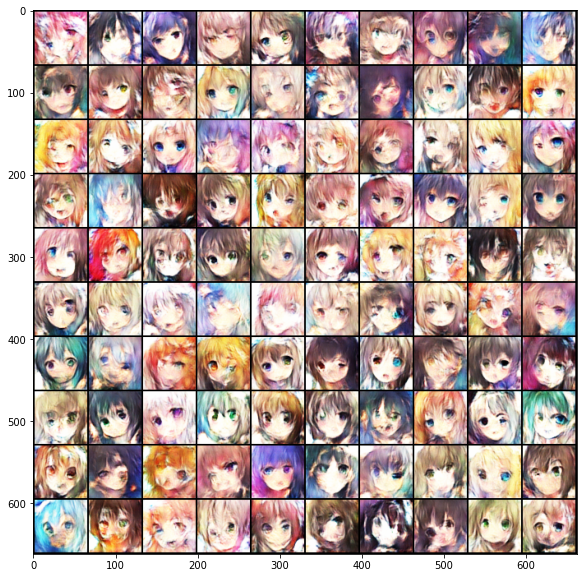

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:02:50<00:00:00  6.55it/s  -1.2199  0.6474   27    30105          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to ./drive/MyDrive/HW6/logs/Epoch_027.jpg.


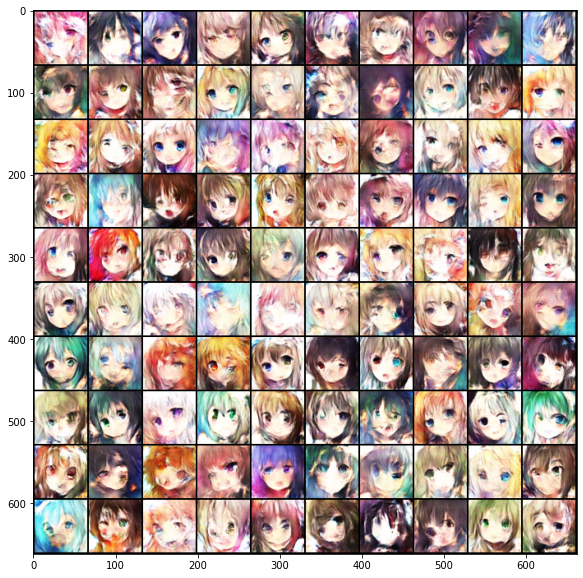

  Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step            
 531/1115  00:01:21<00:01:29  6.50it/s  -0.7359  0.6774   28    30636           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

In [15]:
steps = 0
for e, epoch in enumerate(range(n_epoch)):
    progress_bar = qqdm(dataloader)
    for i, data in enumerate(progress_bar):
        imgs = data
        imgs = imgs.cuda()

        bs = imgs.size(0)

        # ============================================
        #  Train D
        # ============================================
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()
        f_imgs = G(z)

        """ Medium: Use WGAN Loss. """
        # Label
        # r_label = torch.ones((bs)).cuda()
        # f_label = torch.zeros((bs)).cuda()

        # # Model forwarding
        # r_logit = D(r_imgs.detach())
        # f_logit = D(f_imgs.detach())
        
        # Compute the loss for the discriminator.
        # r_loss = criterion(r_logit, r_label)
        # f_loss = criterion(f_logit, f_label)
        # loss_D = (r_loss + f_loss) / 2

        # WGAN Loss
        loss_D = -torch.mean(D(r_imgs)) + torch.mean(D(f_imgs))
       

        # Model backwarding
        D.zero_grad()
        loss_D.backward()

        # Update the discriminator.
        opt_D.step()

        """ Medium: Clip weights of discriminator. """
        for p in D.parameters():
           p.data.clamp_(-clip_value, clip_value)

        # ============================================
        #  Train G
        # ============================================
        if steps % n_critic == 0:
            # Generate some fake images.
            z = Variable(torch.randn(bs, z_dim)).cuda()
            f_imgs = G(z)

            # Model forwarding
            f_logit = D(f_imgs)
            
            """ Medium: Use WGAN Loss"""
            # Compute the loss for the generator.
            # loss_G = criterion(f_logit, r_label)
            # WGAN Loss
            loss_G = -torch.mean(D(f_imgs))

            # Model backwarding
            G.zero_grad()
            loss_G.backward()

            # Update the generator.
            opt_G.step()

        steps += 1
        
        # Set the info of the progress bar
        #   Note that the value of the GAN loss is not directly related to
        #   the quality of the generated images.
        progress_bar.set_infos({
            'Loss_D': round(loss_D.item(), 4),
            'Loss_G': round(loss_G.item(), 4),
            'Epoch': e+1,
            'Step': steps,
        })

    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(log_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f' | Save some samples to {filename}.')
    
    # Show generated images in the jupyter notebook.
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10,10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()

    if (e+1) % 5 == 0 or e == 0:
        # Save the checkpoints.
        torch.save({'epoch': epoch,
                   'model_state_dict' : G.state_dict(),
                   'optimizer_state_dict': opt_G.state_dict(),
                   'loss': loss_G},
                   os.path.join(ckpt_dir, 'G.pth'))
        
        torch.save({'epoch': epoch,
                   'model_state_dict' : D.state_dict(),
                   'optimizer_state_dict': opt_D.state_dict(),
                   'loss': loss_D},
                   os.path.join(ckpt_dir, 'D.pth'))

## Inference
Use the trained model to generate anime faces!

### Load model 

In [16]:
import torch

G = Generator(z_dim)
G.load_state_dict(torch.load(os.path.join(ckpt_dir, 'G.pth')))
G.eval()
G.cuda()

### Generate and show some images.


In [ ]:
# Generate 1000 images and make a grid to save them.
n_output = 1000
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0
log_dir = os.path.join(workspace_dir, 'logs')
filename = os.path.join(log_dir, 'result.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)

# Show 32 of the images.
grid_img = torchvision.utils.make_grid(imgs_sample[:32].cpu(), nrow=10)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

### Compress the generated images using **tar**.


In [ ]:
# Save the generated images.
os.makedirs('output', exist_ok=True)
for i in range(1000):
    torchvision.utils.save_image(imgs_sample[i], f'output/{i+1}.jpg')
  
# Compress the images.
%cd output
!tar -zcf ../images.tgz *.jpg
%cd ..

from google.colab import files
files.download("images.tgz")